In [180]:
import os
from os import listdir
from os import path
from os.path import isfile, join, getsize
import re
import pandas as pd

import json
import io
import glob
import matplotlib.pyplot as plt
import numpy as np
#need this for some stupid reason to import essentia
import sys
sys.path.append("/usr/local/lib/python3.8/site-packages")
import essentia
import essentia.standard as es

In [181]:
ext_drive_dir = '/home/jupyter-dhyan.shah/Capstone/Music/'
os.chdir(ext_drive_dir)

In [182]:
filename_list1 = []
filestem_list1 = []
result=[]

#find all file pairs
for f in glob.glob("*.mp3"):
    filename_list1.append(f)

In [183]:
#split the filenames
for f in filename_list1:
    filestem = f.split('.')
    filestem_list1.append([filestem[0],filestem[1]])
    
filename_list2 = filename_list1

file1 = ext_drive_dir+'1.netta-toy-toy_6Cpy.c6a5acf3d469fa734152ed941ee50df800b73767.json'

#with open(filename_list1, "r") as infile:
#    result.append(infile)

In [184]:
filename_list1

['netta-toy-toy_6Cpy.mp3',
 'the-white-stripers-seven-nation-army_6Org.mp3',
 'ice-ice-baby-vanilla-ice_40Cpy.mp3',
 'queen-under-pressure-queen-david-bowie_40Org.mp3']

In [185]:
# Compute all features, aggregate only 'mean' and 'stdev' statistics for all low-level, rhythm and tonal frame features
features, features_frames = es.MusicExtractor(lowlevelStats=['mean', 'median', 'stdev'], 
                                              rhythmStats=['mean', 'median', 'stdev'], 
                                              tonalStats=['mean', 'median', 'stdev'])(filename_list1[0])

In [186]:
#print(sorted(features.descriptorNames()))

print("Filename:", features['metadata.tags.file_name'])
print("-"*80)
print("Replay gain:", features['metadata.audio_properties.replay_gain'])
print("EBU128 integrated loudness:", features['lowlevel.loudness_ebu128.integrated'])
print("EBU128 loudness range:", features['lowlevel.loudness_ebu128.loudness_range'])
print("-"*80)
print("MFCC mean:", features['lowlevel.mfcc.mean'])
print("-"*80)
print("BPM:", features['rhythm.bpm'])
print("Beat positions (sec.)", features['rhythm.beats_position'])
print("-"*80)
print("Key/scale estimation (using a profile specifically suited for electronic music):", 
      features['tonal.key_edma.key'], features['tonal.key_edma.scale'])

Filename: netta-toy-toy_6Cpy.mp3
--------------------------------------------------------------------------------
Replay gain: -11.23907470703125
EBU128 integrated loudness: -11.032448768615723
EBU128 loudness range: 6.87921142578125
--------------------------------------------------------------------------------
MFCC mean: [-676.5452      98.1689     -16.637775    -1.2536232   -8.58236
    2.0383885    2.2451358    3.9907863   -2.0412514    4.44746
    4.9241643    1.7399344    6.2754936]
--------------------------------------------------------------------------------
BPM: 129.85296630859375
Beat positions (sec.) [  0.9404082   1.8575964   2.7747846   3.7035828   4.643991    5.561179
   6.4899774   7.4071655   8.347573    9.264762   10.20517    11.122358
  12.051156   12.979955   13.908752   14.825941   15.766349   16.706757
  17.647165   18.599184   19.5512     20.50322    21.466848   22.430475
  23.359274   24.288073   25.205261   26.122448   27.051247   27.980045
  28.897234   29.8

In [187]:
numpy_data_0 = np.array([features['lowlevel.mfcc.mean']])

In [188]:
numpy_data_0

array([[-676.5452   ,   98.1689   ,  -16.637775 ,   -1.2536232,
          -8.58236  ,    2.0383885,    2.2451358,    3.9907863,
          -2.0412514,    4.44746  ,    4.9241643,    1.7399344,
           6.2754936]], dtype=float32)

In [189]:
# Compute all features, aggregate only 'mean' and 'stdev' statistics for all low-level, rhythm and tonal frame features
features, features_frames = es.MusicExtractor(lowlevelStats=['mean', 'median', 'stdev'], 
                                              rhythmStats=['mean', 'median', 'stdev'], 
                                              tonalStats=['mean', 'median', 'stdev'])(filename_list1[1])

In [190]:
print("Filename:", features['metadata.tags.file_name'])
print("-"*80)

print("MFCC mean:", features['lowlevel.mfcc.mean'])
print("-"*80)



Filename: the-white-stripers-seven-nation-army_6Org.mp3
--------------------------------------------------------------------------------
MFCC mean: [-734.1536     101.25372     34.06335     59.479275    15.392394
   14.820745     9.003297    13.754552     3.5451124    2.2030766
   -2.569848     6.282368     1.6650873]
--------------------------------------------------------------------------------


In [191]:
numpy_data_1 = np.array([features['lowlevel.mfcc.mean']])

In [192]:
numpy_data_1

array([[-734.1536   ,  101.25372  ,   34.06335  ,   59.479275 ,
          15.392394 ,   14.820745 ,    9.003297 ,   13.754552 ,
           3.5451124,    2.2030766,   -2.569848 ,    6.282368 ,
           1.6650873]], dtype=float32)

In [193]:
# Compute all features, aggregate only 'mean' and 'stdev' statistics for all low-level, rhythm and tonal frame features
features, features_frames = es.MusicExtractor(lowlevelStats=['mean', 'median', 'stdev'], 
                                              rhythmStats=['mean', 'median', 'stdev'], 
                                              tonalStats=['mean', 'median', 'stdev'])(filename_list1[2])

In [194]:
print("Filename:", features['metadata.tags.file_name'])
print("-"*80)

print("MFCC mean:", features['lowlevel.mfcc.mean'])
print("-"*80)



Filename: ice-ice-baby-vanilla-ice_40Cpy.mp3
--------------------------------------------------------------------------------
MFCC mean: [-7.3614929e+02  1.1283252e+02  4.9813576e+01  4.5874165e+01
  1.4619951e+01  7.8034997e+00  4.8571950e-01  9.5439672e+00
 -2.6492149e-01  3.2964377e+00  1.3968589e+00  3.7113541e-01
  2.1898739e+00]
--------------------------------------------------------------------------------


In [195]:
numpy_data_2 = np.array([features['lowlevel.mfcc.mean']])

In [196]:
numpy_data_2

array([[-7.3614929e+02,  1.1283252e+02,  4.9813576e+01,  4.5874165e+01,
         1.4619951e+01,  7.8034997e+00,  4.8571950e-01,  9.5439672e+00,
        -2.6492149e-01,  3.2964377e+00,  1.3968589e+00,  3.7113541e-01,
         2.1898739e+00]], dtype=float32)

In [197]:
# Compute all features, aggregate only 'mean' and 'stdev' statistics for all low-level, rhythm and tonal frame features
features, features_frames = es.MusicExtractor(lowlevelStats=['mean', 'median', 'stdev'], 
                                              rhythmStats=['mean', 'median', 'stdev'], 
                                              tonalStats=['mean', 'median', 'stdev'])(filename_list1[3])

In [198]:
print("Filename:", features['metadata.tags.file_name'])
print("-"*80)

print("MFCC mean:", features['lowlevel.mfcc.mean'])
print("-"*80)

Filename: queen-under-pressure-queen-david-bowie_40Org.mp3
--------------------------------------------------------------------------------
MFCC mean: [-650.1163     109.41911      1.1149791   12.223903    -1.5672529
    4.5511074   -1.9408118    5.4722166   -1.706132     1.9112672
   -2.1773136   -2.0911248   -3.1334288]
--------------------------------------------------------------------------------


In [199]:
numpy_data_3 = np.array([features['lowlevel.mfcc.mean']])

In [200]:
numpy_data_3

array([[-650.1163   ,  109.41911  ,    1.1149791,   12.223903 ,
          -1.5672529,    4.5511074,   -1.9408118,    5.4722166,
          -1.706132 ,    1.9112672,   -2.1773136,   -2.0911248,
          -3.1334288]], dtype=float32)

In [201]:
df_MFCC = pd.DataFrame(data=numpy_data_0, index=["MFCC_Mean_6_Cpy"], columns=["1","2","3","4","5","6","7","8","9","10","11","12","13"])
df_MFCCt_0 = df_MFCC.transpose()
print(df_MFCCt_0)

    MFCC_Mean_6_Cpy
1       -676.545227
2         98.168900
3        -16.637775
4         -1.253623
5         -8.582360
6          2.038388
7          2.245136
8          3.990786
9         -2.041251
10         4.447460
11         4.924164
12         1.739934
13         6.275494


In [202]:
df_MFCC = pd.DataFrame(data=numpy_data_1, index=["MFCC_Mean_6_Org"], columns=["1","2","3","4","5","6","7","8","9","10","11","12","13"])
df_MFCCt_1 = df_MFCC.transpose()
print(df_MFCCt_1)

    MFCC_Mean_6_Org
1       -734.153625
2        101.253723
3         34.063351
4         59.479275
5         15.392394
6         14.820745
7          9.003297
8         13.754552
9          3.545112
10         2.203077
11        -2.569848
12         6.282368
13         1.665087


In [203]:
df_MFCC = pd.DataFrame(data=numpy_data_2, index=["MFCC_Mean_40_Cpy"], columns=["1","2","3","4","5","6","7","8","9","10","11","12","13"])
df_MFCCt_2 = df_MFCC.transpose()
print(df_MFCCt_2)

    MFCC_Mean_40_Cpy
1        -736.149292
2         112.832520
3          49.813576
4          45.874165
5          14.619951
6           7.803500
7           0.485720
8           9.543967
9          -0.264921
10          3.296438
11          1.396859
12          0.371135
13          2.189874


In [204]:
df_MFCC = pd.DataFrame(data=numpy_data_3, index=["MFCC_Mean_40_Org"], columns=["1","2","3","4","5","6","7","8","9","10","11","12","13"])
df_MFCCt_3 = df_MFCC.transpose()
print(df_MFCCt_3)

    MFCC_Mean_40_Org
1        -650.116272
2         109.419113
3           1.114979
4          12.223903
5          -1.567253
6           4.551107
7          -1.940812
8           5.472217
9          -1.706132
10          1.911267
11         -2.177314
12         -2.091125
13         -3.133429


In [216]:
MFCC1 = pd.merge(df_MFCCt_1, df_MFCCt_0, left_index=True, right_index=True)

In [217]:
MFCC2 = pd.merge(df_MFCCt_3, df_MFCCt_2, left_index=True, right_index=True)

In [218]:
MFCC = pd.merge(MFCC1, MFCC2, left_index=True, right_index=True)
MFCC

,MFCC_Mean_6_Org,MFCC_Mean_6_Cpy,MFCC_Mean_40_Org,MFCC_Mean_40_Cpy
1,-734.153625,-676.545227,-650.116272,-736.149292
2,101.253723,98.168900,109.419113,112.832520
3,34.063351,-16.637775,1.114979,49.813576
4,59.479275,-1.253623,12.223903,45.874165
5,15.392394,-8.582360,-1.567253,14.619951
6,14.820745,2.038388,4.551107,7.803500
7,9.003297,2.245136,-1.940812,0.485720
8,13.754552,3.990786,5.472217,9.543967
9,3.545112,-2.041251,-1.706132,-0.264921
10,2.203077,4.447460,1.911267,3.296438


In [219]:
import essentia.standard as estd
from essentia.pytools.spectral import hpcpgram
%matplotlib inline
import matplotlib.pyplot as plt

#todo make this loop through correct pairs
song_1 = estd.MonoLoader(filename=filename_list1[0], sampleRate=32000)()
song_2 = estd.MonoLoader(filename=filename_list1[1], sampleRate=32000)()
song_random = estd.MonoLoader(filename=filename_list1[3], sampleRate=32000)()

song_1_hpcp = hpcpgram(song_1, sampleRate=32000)
song_2_hpcp = hpcpgram(song_2, sampleRate=32000)
song_random_hpcp = hpcpgram(song_random, sampleRate=32000)

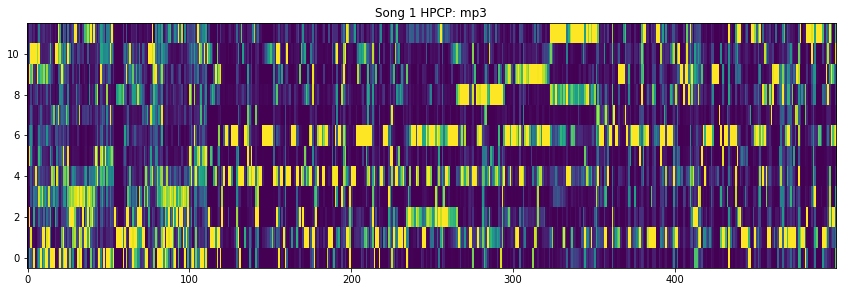

In [222]:
fig = plt.gcf()
fig.set_size_inches(14.5, 4.5)

plt.title("Song 1 HPCP: " + filestem_list1[0][1])
plt.imshow(song_1_hpcp[:500].T, aspect='auto', origin='lower', interpolation='none')

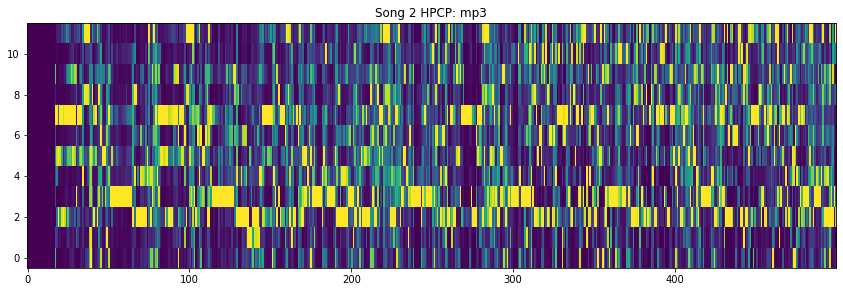

In [223]:
fig = plt.gcf()
fig.set_size_inches(14.5, 4.5)

plt.title("Song 2 HPCP: " + filestem_list1[1][1])
plt.imshow(song_2_hpcp[:500].T, aspect='auto', origin='lower', interpolation='none')

In [224]:
#todo make this loop through correct pairs
song_3 = estd.MonoLoader(filename=filename_list1[2], sampleRate=32000)()
song_4 = estd.MonoLoader(filename=filename_list1[3], sampleRate=32000)()
song_random = estd.MonoLoader(filename=filename_list1[3], sampleRate=32000)()

song_3_hpcp = hpcpgram(song_3, sampleRate=32000)
song_4_hpcp = hpcpgram(song_4, sampleRate=32000)
song_random_hpcp = hpcpgram(song_random, sampleRate=32000)

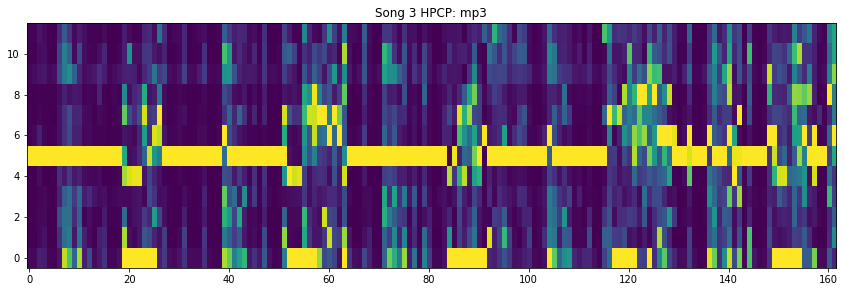

In [233]:
fig = plt.gcf()
fig.set_size_inches(14.5, 4.5)

plt.title("Song 3 HPCP: " + filestem_list1[2][1])
plt.imshow(song_3_hpcp[138:300].T, aspect='auto', origin='lower', interpolation='none')

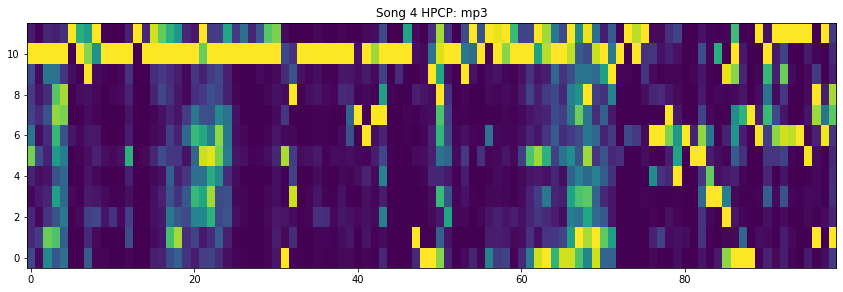

In [232]:
fig = plt.gcf()
fig.set_size_inches(14.5, 4.5)

plt.title("Song 4 HPCP: " + filestem_list1[3][1])
plt.imshow(song_4_hpcp[1:100].T, aspect='auto', origin='lower', interpolation='none')

In [242]:
# we start by instantiating the audio loader:
loader = essentia.standard.MonoLoader(filename='/home/jupyter-dhyan.shah/Capstone/Music/ice-ice-baby-vanilla-ice_40Cpy.mp3')

# and then we actually perform the loading:
audio = loader()

In [243]:
# we start by instantiating the audio loader:
loader = essentia.standard.MonoLoader(filename='/home/jupyter-dhyan.shah/Capstone/Music/queen-under-pressure-queen-david-bowie_40Org.mp3')

# and then we actually perform the loading:
audio1 = loader()

In [244]:
# This is how the audio we want to process sounds like
import IPython
IPython.display.Audio('/home/jupyter-dhyan.shah/Capstone/Music/ice-ice-baby-vanilla-ice_40Cpy.mp3')

In [245]:
# This is how the audio we want to process sounds like
import IPython
IPython.display.Audio('/home/jupyter-dhyan.shah/Capstone/Music/queen-under-pressure-queen-david-bowie_40Org.mp3')

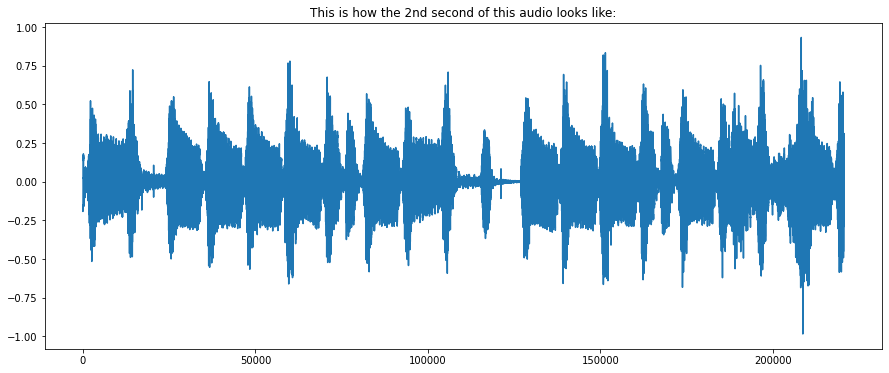

In [239]:
# pylab contains the plot() function, as well as figure, etc... (same names as Matlab)
from pylab import plot, show, figure, imshow
%matplotlib inline
import matplotlib.pyplot as plt
plt.rcParams['figure.figsize'] = (15, 6) # set plot sizes to something larger than default

plot(audio[10*44100:15*44100])
plt.title("This is how the 10-15th second of this audio looks like:")
show() # unnecessary if you started "ipython --pylab"

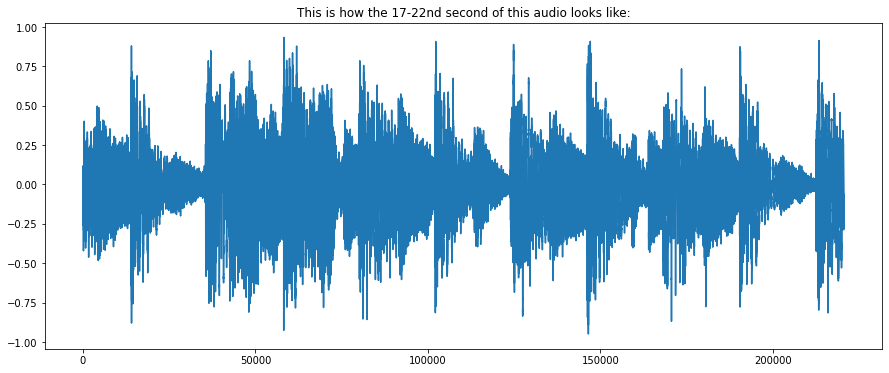

In [246]:
# pylab contains the plot() function, as well as figure, etc... (same names as Matlab)
from pylab import plot, show, figure, imshow
%matplotlib inline
import matplotlib.pyplot as plt
plt.rcParams['figure.figsize'] = (15, 6) # set plot sizes to something larger than default

plot(audio1[17*44100:22*44100])
plt.title("This is how the 17-22nd second of this audio looks like:")
show() # unnecessary if you started "ipython --pylab"

In [234]:
# Dynamic Time Wrapping
# We define two sequences x, y as numpy array
# where y is actually a sub-sequence from x
numpy_data_2 = np.array([features['lowlevel.mfcc.mean']]).reshape(-1,1) ## x
numpy_data_3 = np.array([features['lowlevel.mfcc.mean']]).reshape(-1,1)## y

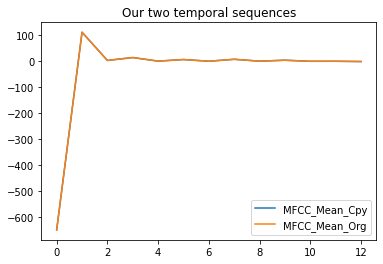

In [235]:
plt.plot(numpy_data_2, label='MFCC_Mean_Cpy')
plt.plot(numpy_data_3, label='MFCC_Mean_Org')
plt.title('Our two temporal sequences')
plt.legend()

In [101]:
df_MFCCt3 = MFCC.transpose()
print(df_MFCCt3)

                         1           2          3          4          5  \
MFCC_Mean__Cpy -676.545227   98.168900 -16.637775  -1.253623  -8.582360   
MFCC_Mean_Org  -734.153625  101.253723  34.063351  59.479275  15.392394   

                        6         7          8         9        10        11  \
MFCC_Mean__Cpy   2.038388  2.245136   3.990786 -2.041251  4.447460  4.924164   
MFCC_Mean_Org   14.820745  9.003297  13.754552  3.545112  2.203077 -2.569848   

                      12        13  
MFCC_Mean__Cpy  1.739934  6.275494  
MFCC_Mean_Org   6.282368  1.665087  


In [96]:
from sklearn import preprocessing
from sklearn.preprocessing import MinMaxScaler
scaler = preprocessing.MinMaxScaler()
scaler = MinMaxScaler() 
MFCC_scaled = scaler.fit_transform(MFCC) 

def scaleColumns(df, cols_to_scale):
    for col in cols_to_scale:
        df[col] = pd.DataFrame(min_max_scaler.fit_transform(pd.DataFrame(dfTest[col])),columns=[col])
    return df







#dfTest = pd.DataFrame({'A':[14.00,90.20,90.95,96.27,91.21],'B':[103.02,107.26,110.35,114.23,114.68], 'C':['big','small','big','small','small']})
#min_max_scaler = preprocessing.MinMaxScaler()

#def scaleColumns(df, cols_to_scale):
#    for col in cols_to_scale:
#       df[col] = pd.DataFrame(min_max_scaler.fit_transform(pd.DataFrame(dfTest[col])),columns=[col])
#    return df

dfTest


In [98]:
MFCC_scaled

array([[0.        , 0.        ],
       [1.        , 1.        ],
       [0.8518077 , 0.91957176],
       [0.8716656 , 0.94999516],
       [0.8622056 , 0.8972223 ],
       [0.8759149 , 0.89653796],
       [0.8761818 , 0.88957435],
       [0.8784351 , 0.8952617 ],
       [0.8706489 , 0.8830408 ],
       [0.8790245 , 0.8814344 ],
       [0.87963986, 0.8757211 ],
       [0.87552965, 0.8863174 ],
       [0.88138413, 0.88079035]], dtype=float32)

In [82]:
# Dynamic Time Wrapping
# We define two sequences x, y as numpy array
# where y is actually a sub-sequence from x
numpy_data = np.array([features['lowlevel.mfcc.mean']]).reshape(-1,1) ## x
numpy_data1 = np.array([features['lowlevel.mfcc.mean']]).reshape(-1,1)## y

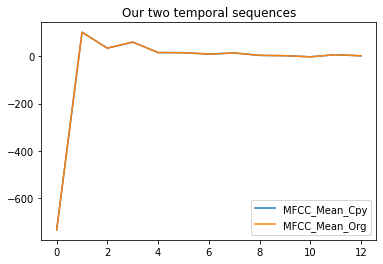

In [83]:
plt.plot(numpy_data, label='MFCC_Mean_Cpy')
plt.plot(numpy_data1, label='MFCC_Mean_Org')
plt.title('Our two temporal sequences')
plt.legend()

In [91]:
## Compute the dynamic time warped distance between x and y
from dtw import dtw

# Here, we use L2 norm as the element comparison distance
l2_norm = lambda numpy_data, numpy_data1: (numpy_data - numpy_data1) ** 2

dist, cost_matrix, acc_cost_matrix, path = dtw(numpy_data, numpy_data1, dist=l2_norm)

dist


#from numpy.linalg import norm
#dist, cost, acc_cost, path = dtw(numpy_data, numpy_data1, dist=lambda numpy_data, numpy_data1: norm(numpy_data - numpy_data1, ord=1))
#print ('Normalized distance between the two sounds:', dist)

0.0

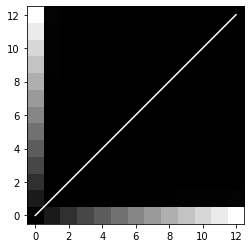

In [95]:
plt.imshow(acc_cost_matrix.T, origin='lower', cmap='gray', interpolation='nearest')
plt.plot(path[0], path[1], 'w')
plt.show()

## ANOVA Hypotheses

### Null hypotheses: 
MFCC means are equal (no variation in means pair songs # 6)

### Alternative hypotheses: 
MFCC mean are different from each other.


In [102]:
# load packages
import scipy.stats as stats
# stats f_oneway functions takes the groups as input and returns F and P-value
fvalue, pvalue = stats.f_oneway(df_MFCCt3['1'], df_MFCCt3['2'],df_MFCCt3['3'],df_MFCCt3['4'],df_MFCCt3['5'],df_MFCCt3['6'],
                               df_MFCCt3['7'],df_MFCCt3['8'],df_MFCCt3['9'],df_MFCCt3['10'],df_MFCCt3['11'],df_MFCCt3['12'],df_MFCCt3['13'])
print(fvalue, pvalue)
# 0.010586104818176857 0.9189061202058034


199.13689760928003 1.0986435350039394e-12


In [103]:
# get ANOVA table as R like output
import statsmodels.api as sm
from statsmodels.formula.api import ols
# reshape the d dataframe suitable for statsmodels package 
d_MFCC = pd.melt(df_MFCCt3.reset_index(), id_vars=['index'], value_vars=['1', '2','3','4','5','6','7','8','9','10','11','12','13'])
# replace column names
d_MFCC.columns = ['index', 'treatments', 'value']
# Ordinary Least Squares (OLS) model
model = ols('value ~ C(treatments)', data=d_MFCC).fit()
anova_table = sm.stats.anova_lm(model, typ=2)
anova_table

,sum_sq,df,F,PR(>F)
C(treatments),974313.297380,12.0,199.136898,1.098644e-12
Residual,5300.404319,13.0,NaN,NaN


In [104]:
# load packages
from statsmodels.stats.multicomp import pairwise_tukeyhsd
# perform multiple pairwise comparison (Tukey HSD)
m_comp = pairwise_tukeyhsd(endog=d_MFCC['value'], groups=d_MFCC['treatments'], alpha=0.05)
print(m_comp)


  Multiple Comparison of Means - Tukey HSD, FWER=0.05  
group1 group2 meandiff p-adj    lower    upper   reject
-------------------------------------------------------
     1     10 708.6747  0.001  628.3572 788.9922   True
     1     11 706.5266  0.001  626.2091  786.844   True
     1     12 709.3606  0.001  629.0431  789.678   True
     1     13 709.3197  0.001  629.0023 789.6372   True
     1      2 805.0607  0.001  724.7433 885.3782   True
     1      3 714.0622  0.001  633.7448 794.3797   True
     1      4 734.4623  0.001  654.1448 814.7797   True
     1      5 708.7544  0.001   628.437 789.0719   True
     1      6  713.779  0.001  633.4615 794.0964   True
     1      7 710.9736  0.001  630.6562 791.2911   True
     1      8 714.2221  0.001  633.9046 794.5396   True
     1      9 706.1014  0.001  625.7839 786.4188   True
    10     11  -2.1481    0.9  -82.4656  78.1693  False
    10     12   0.6859    0.9  -79.6316  81.0033  False
    10     13    0.645    0.9  -79.6724  80.9625

### Song # 40

In [111]:
#split the filenames
for f in filename_list1:
    filestem = f.split('.')
    filestem_list1.append([filestem[0],filestem[1],filestem[2],filestem[3]])
    
filename_list2 = filename_list1

file1 = ext_drive_dir+'1.Juice WRLD - Lucid Dreams_Cpy.c6a5acf3d469fa734152ed941ee50df800b73767.json'

#with open(filename_list1, "r") as infile:
#    result.append(infile)

IndexError: list index out of range